In [1]:
import pickle
import pandas as pd
import gensim
import csv
import random

/home/nicholas/.local/lib/python3.6/site-packages/smart_open/ssh.py:34: UserWarning: paramiko missing, opening SSH/SCP/SFTP paths will be disabled.  `pip install paramiko` to suppress
  warnings.warn('paramiko missing, opening SSH/SCP/SFTP paths will be disabled.  `pip install paramiko` to suppress')


In [2]:
with open('../../data/tensor3.pkl', 'rb') as f:
    data = pickle.load(f)

In [3]:
data


D00290.003_SELEX_ALX3  D00292.001_SELEX_ALX4  \
100007_raw 1-0                  0.233633              -0.009496   
           1-1                 -0.258342               0.029549   
           1-10                46.199988               3.475145   
           1-100               60.051663              29.272099   
           1-1000              -2.685523             -14.813843   
           1-1001               4.705516              -4.780305   
           1-1002             -13.771291             -11.619157   
           1-1003              20.214893              -3.467312   
           1-1004              -4.244517              -2.570786   
           1-1005               0.366445              -3.491856   
           1-1006               9.011455              -1.103790   
           1-1007               8.499811              -1.974816   
           1-1008             -10.992522              14.601011   
           1-1009               7.340064               7.593170   
           1-101               -9.906465             -14.264758   
           1-1010              -0.754833               5.334964   
           1-1011               3.534911               2.262487   
           1-1012              -0.543469              -3.467030   
           1-1013              10.209665              12.702922   
           1-1014              -7.313896              -4.764818   
           1-1015              -7.532110             -10.523312   
           1-1016             -14.359990              -1.300698   
           1-1017              -4.872284             -14.158611   
           1-1018              14.344668               4.876861   
           1-1019               1.512960               1.109143   
           1-102               -7.038123              -2.424674   
           1-1020              -9.856186             -12.745503   
           1-1021             -24.624511              -2.227445   
           1-1022             -27.969493               4.200149   
           1-1023               2.257808               6.001280   
...                                  ...                    ...   
757_irnt   1-972                0.647797              -5.871198   
           1-973               25.004408               4.373124   
           1-974              -17.571871               2.570175   
           1-975                3.541156               7.600391   
           1-976               -4.398430              10.233435   
           1-977               -0.653355              -4.477253   
           1-978              -18.002176             -18.290009   
           1-979              -20.552192              42.432979   
           1-98                -4.576515              -5.417648   
           1-980               19.539144              20.042327   
           1-981               -0.794316              14.488653   
           1-982               10.200321             -35.412684   
           1-983               28.786365              -6.123262   
           1-984               90.977924             -27.430215   
           1-985               20.879767               1.830986   
           1-986                3.014047              12.666719   
           1-987               -6.549366               0.629852   
           1-988               -0.527058               4.274955   
           1-989                1.748537              -1.750331   
           1-99                -7.788918              -7.611569   
           1-990               -2.868851              -0.182491   
           1-991               -5.938324               2.493521   
           1-992              -15.769198               2.132362   
           1-993               36.513615              41.116373   
           1-994               -6.268132              -2.855267   
           1-995              -18.286816              -7.105736   
           1-996               10.212257               7.599330   
           1-997                5.432915               6.404061   

In [4]:
import matplotlib.pyplot as plt
import numpy as np
blah = np.array(data['D00571.002_SELEX_PAX2'])
blah
plt.hist(blah, bins=100)
plt.show()


<Figure size 640x480 with 1 Axes>

In [5]:
# for column in data.columns:
#     data[column] = (data[column] - data[column].mean())/data[column].std()


In [6]:
code_mapper = {}
with open('../../data/gwas_names.csv', 'r') as f:
    reader = csv.reader(f)
    for row in reader:
        code = row[0]
        name = row[1]
        code_mapper[code] = name

In [7]:
thresh = 5
documents = {}
for index, row in data.iterrows():
    disease, location = index
    for tf, score in row.iteritems():
        if abs(score) > thresh:
            disease_name = code_mapper.get(disease, disease)
            doc_key = str((location,tf))
            word_key = str(disease_name)
            if doc_key not in documents:
                documents[doc_key] = []
            documents[doc_key].append(word_key)
    

In [8]:
dct = gensim.corpora.Dictionary(documents.values())
kvs = list(documents.items())
corpus = [dct.doc2bow(text) for key, text in kvs]


In [9]:
# keys = sorted(documents.keys(), key=lambda a: int(a.split('-')[1]))


In [26]:
# cmp = lambda kv: int(kv[0].split('-')[1])
# dct = gensim.corpora.Dictionary(documents.values())
# kvs = list(documents.items())
# random.shuffle(kvs)
# kvs_test = kvs[:len(kvs) // 10]
# kvs_train = kvs[len(kvs) // 10:]
# kvs.sort(key=cmp)
# kvs_train.sort(key=cmp)
# kvs_test.sort(key=cmp)
# corpus = [dct.doc2bow(text) for key, text in kvs]
# corpus_train = [dct.doc2bow(text) for key, text in kvs_train]
# corpus_test = [dct.doc2bow(text) for key, text in kvs_test]

# genomic_locations = [cmp(kv) for kv in kvs]
# print(genomic_locations)
#genomic_locations = [cmp(kv) for kv in kvs]

NameError: name 'cmp' is not defined

In [ ]:
for kv in kvs:
    print(kv)
    import time
    time.sleep(0.001)

("('1-10', 'D00290.003_SELEX_ALX3')", ['Polyunsaturated fat', 'Total sugars', 'Duration of strenuous sports', 'Drinking water intake', 'Coffee consumed', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Sweets intake', 'Pulse rate- automated reading', 'Frequency of friend/family visits', 'Fruit consumers', 'Time spend outdoors in summer', 'Time spent driving', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Morning/evening person (chronotype)', 'Nap during day', 'Sleeplessness / insomnia', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Ease of skin tanning', 'Mood swings', 'Miserableness', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: larynx/throat cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: leukaemia', 'Cancer code- self-reported: ma

("('1-10', 'D00576.005_SELEX_PAX7')", ['Polyunsaturated fat', 'Total sugars', 'Duration of strenuous sports', 'Frequency of friend/family visits', 'Fruit consumers', 'Time spent doing vigorous physical activity', 'Time spent driving', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Morning/evening person (chronotype)', 'Sleeplessness / insomnia', 'Current tobacco smoking', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Ease of skin tanning', 'Facial ageing', 'Mood swings', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: prostate cancer', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: heart attack/myocardial infarction', 'Non-cancer illness code- self-reported: heart arrhythmia', 'Non-cancer illness code- self-reported: cardiomyopathy', 'Non-cancer illness code- self-reported: asthma', 'Non-cancer illness code- self-reported: slee

("('1-10', 'D00825.001_ChIP-seq_ZBTB33')", ['Polyunsaturated fat', 'Drinking water intake', 'Coffee consumed', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Frequency of friend/family visits', 'Time spend outdoors in summer', 'Time spent driving', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Sleep duration', 'Morning/evening person (chronotype)', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Ease of skin tanning', 'Facial ageing', 'Mood swings', 'Miserableness', 'Irritability', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: leukaemia', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reported: hypertension', 'N

("('1-100', 'D00580.005_SELEX_PHOX2B')", ['Polyunsaturated fat', 'Total sugars', 'Duration of strenuous sports', 'Coffee consumed', 'Alcohol consumed', 'Pulse rate- automated reading', 'Fruit consumers', 'Time spent doing vigorous physical activity', 'Time spend outdoors in summer', 'Time spent driving', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Sleep duration', 'Nap during day', 'Sleeplessness / insomnia', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Ease of skin tanning', 'Facial ageing', 'Mood swings', 'Miserableness', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: larynx/throat cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reporte

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



("('1-1012', 'D00804.002_ChIP-seq_SIN3A')", ['Polyunsaturated fat', 'Total sugars', 'Duration of strenuous sports', 'Drinking water intake', 'Coffee consumed', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Sweets intake', 'Pulse rate- automated reading', 'Drive faster than motorway speed limit', 'Morning/evening person (chronotype)', 'Nap during day', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Facial ageing', 'Mood swings', 'Miserableness', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: leukaemia', 'Non-cancer illness code- self-reported: hypertension', 'Non-cancer illness code- self-reported: angina', 'Non-cancer illness code- self-reported: heart attack/myocardial infarction', 'Non-cancer illness code- self-reported: cardiomyopathy', 'Non-cancer illness code- self-reported: liver/biliary/pancreas problem', 'Non-cancer illness code- self-reported: irritable bowel syndrome', 'Non-cancer illness code- self-reported: bladd

("('1-1014', 'D00481.003_SELEX_IRX2')", ['Polyunsaturated fat', 'Total sugars', 'Duration of strenuous sports', 'Drinking water intake', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Time spent doing vigorous physical activity', 'Time spend outdoors in summer', 'Time spent driving', 'Morning/evening person (chronotype)', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Ease of skin tanning', 'Facial ageing', 'Mood swings', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: larynx/throat cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: leukaemia', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reported: hypertension', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: periphera

("('1-1015', 'D00673.001_SELEX_TCF4')", ['Polyunsaturated fat', 'Total sugars', 'Drinking water intake', 'Coffee consumed', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Sweets intake', 'Fruit consumers', 'Time spend outdoors in summer', 'Time spent driving', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Sleep duration', 'Morning/evening person (chronotype)', 'Nap during day', 'Sleeplessness / insomnia', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Ease of skin tanning', 'Facial ageing', 'Mood swings', 'Miserableness', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: leukaemia', 'Cancer code- self-reported: malig

("('1-1016', 'D00580.005_SELEX_PHOX2B')", ['Polyunsaturated fat', 'Drinking water intake', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Sweets intake', 'Pulse rate- automated reading', 'Time spent doing vigorous physical activity', 'Time spent driving', 'Drive faster than motorway speed limit', 'Sleep duration', 'Morning/evening person (chronotype)', 'Nap during day', 'Sleeplessness / insomnia', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Ease of skin tanning', 'Mood swings', 'Miserableness', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: larynx/throat cancer', 'Cancer code- self-reported: leukaemia', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reported: hypertension', 'Non-cancer illness code- se

("('1-1017', 'D00383.002_SELEX_ETV5')", ['Polyunsaturated fat', 'Total sugars', 'Drinking water intake', 'Coffee consumed', 'Frequency of light DIY in last 4 weeks', 'Pulse rate- automated reading', 'Frequency of friend/family visits', 'Fruit consumers', 'Time spent driving', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Sleep duration', 'Morning/evening person (chronotype)', 'Nap during day', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Ease of skin tanning', 'Mood swings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Non-cancer illness code- self-reported: hypertension', 'Non-cancer illness code- self-reported: peripheral vascular disease', 'Non-cancer illness code- self-reported: heart attack/myocardial infarction', 'Non-cancer illness 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



("('1-1025', 'D00385.002_SELEX_EVX1')", ['Polyunsaturated fat', 'Total sugars', 'Duration of strenuous sports', 'Coffee consumed', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Frequency of friend/family visits', 'Fruit consumers', 'Time spent doing vigorous physical activity', 'Time spend outdoors in summer', 'Time spent driving', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Sleep duration', 'Morning/evening person (chronotype)', 'Nap during day', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Facial ageing', 'Mood swings', 'Miserableness', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-

("('1-1025', 'D00757.001_ChIP-seq_FAM48A')", ['Polyunsaturated fat', 'Duration of strenuous sports', 'Frequency of light DIY in last 4 weeks', 'Frequency of friend/family visits', 'Fruit consumers', 'Time spend outdoors in summer', 'Drive faster than motorway speed limit', 'Sleep duration', 'Nap during day', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Skin colour', 'Miserableness', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reported: hypertension', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: peripheral vascular disease', 'Non-cancer illness code- self-reported: angina', 'Non-cancer illness code- self-reported: heart attack/myocardial infarction', 'Non-cancer illness code-

("('1-1026', 'D00680.001_SELEX_TEF')", ['Polyunsaturated fat', 'Duration of strenuous sports', 'Drinking water intake', 'Coffee consumed', 'Alcohol consumed', 'Sweets intake', 'Frequency of friend/family visits', 'Fruit consumers', 'Time spent doing vigorous physical activity', 'Time spend outdoors in summer', 'Time spent driving', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Morning/evening person (chronotype)', 'Nap during day', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Ease of skin tanning', 'Facial ageing', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: leukaemia', 'Non-cancer illness code- self-reported: hypertension', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: peripheral vascular disease', 'Non-cancer illness code- self-reported: angina', 'Non-cancer

("('1-1027', 'D00723.006_ChIP-seq_ZNF143')", ['Polyunsaturated fat', 'Total sugars', 'Duration of strenuous sports', 'Drinking water intake', 'Coffee consumed', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Pulse rate- automated reading', 'Frequency of friend/family visits', 'Time spend outdoors in summer', 'Drive faster than motorway speed limit', 'Morning/evening person (chronotype)', 'Nap during day', 'Sleeplessness / insomnia', 'Mood swings', 'Irritability', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: leukaemia', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: peripheral vascular disease', 'Non-cancer illness code- self-reported: sleep apnoea', 'Non-cancer illness code- self-reported: hepatitis', 'Non-cancer illness code- self-reported: bladder problem (not cancer)', 'Non-cancer illness code- self-reported: parkinsons disease', 'Non-cancer illness code- self-reported: epilepsy

("('1-1028', 'D00797.001_ChIP-seq_RBBP5')", ['Polyunsaturated fat', 'Morning/evening person (chronotype)', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Ease of skin tanning', 'Facial ageing', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reported: hypertension', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: angina', 'Non-cancer illness code- self-reported: heart attack/myocardial infarction', 'Non-cancer illness code- self-reported: asthma', 'Non-cancer illness code- self-reported: irritable bowel syndrome', 'Non-cancer illness code- self-reported: bladder problem (not cancer)', 'Non-cancer illness code- self-reported: multiple sclerosis', 'Non-cancer illness code- self-reported:

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



("('1-1042', 'D00798.001_ChIP-seq_RCOR1')", ['Polyunsaturated fat', 'Coffee consumed', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Sweets intake', 'Alcohol intake frequency.', 'Skin colour', 'Miserableness', 'Cancer code- self-reported: lung cancer', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: asthma', 'Non-cancer illness code- self-reported: sleep apnoea', 'Non-cancer illness code- self-reported: stomach disorder', 'Non-cancer illness code- self-reported: depression', 'Non-cancer illness code- self-reported: anxiety/panic attacks', 'Non-cancer illness code- self-reported: back problem', 'Non-cancer illness code- self-reported: allergy/hypersensitivity/anaphylaxis', 'Non-cancer illness code- self-reported: alcohol dependency', 'Non-cancer illness code- self-reported: crohns disease', 'Non-cancer illness code- self-reported: back pain', 'Fluid intelligence score', ' Prospective memory result', 'Loneliness- 

("('1-1044', 'D00312.002_SELEX_BHLHE41')", ['Polyunsaturated fat', 'Duration of strenuous sports', 'Coffee consumed', 'Sweets intake', 'Frequency of friend/family visits', 'Time spent driving', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Nap during day', 'Sleeplessness / insomnia', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Facial ageing', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: larynx/throat cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: angina', 'Non-cancer illness code- self-reported: cardiomyopathy', 'Non-cancer illness code- self-reported: stroke', 'Non-cancer illness code- self-reported: sleep apnoea', 'Non-cancer illness code- self-reported: hepatitis', 'Non-cancer illness code- self-report

("('1-1045', 'D00317.003_SELEX_CEBPB')", ['Polyunsaturated fat', 'Total sugars', 'Drinking water intake', 'Coffee consumed', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Sweets intake', 'Pulse rate- automated reading', 'Frequency of friend/family visits', 'Fruit consumers', 'Time spent doing vigorous physical activity', 'Time spend outdoors in summer', 'Time spent driving', 'Drive faster than motorway speed limit', 'Sleep duration', 'Morning/evening person (chronotype)', 'Nap during day', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Ease of skin tanning', 'Facial ageing', 'Miserableness', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- s

("('1-1046', 'D00534.003_SELEX_NFATC1')", ['Polyunsaturated fat', 'Total sugars', 'Drinking water intake', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Frequency of friend/family visits', 'Fruit consumers', 'Time spend outdoors in summer', 'Time spent driving', 'Length of mobile phone use', 'Sleep duration', 'Morning/evening person (chronotype)', 'Nap during day', 'Sleeplessness / insomnia', 'Current tobacco smoking', 'Ease of skin tanning', 'Facial ageing', 'Miserableness', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: larynx/throat cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: leukaemia', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reported: hypertension', 'Non-cancer illness code- self-reported: peripheral vascular disease', 'Non-cancer illness code- self-reported: heart attack/myocardial infarct

("('1-1047', 'D00744.001_ChIP-seq_BCLAF1')", ['Polyunsaturated fat', 'Total sugars', 'Duration of strenuous sports', 'Sweets intake', 'Pulse rate- automated reading', 'Fruit consumers', 'Time spent doing vigorous physical activity', 'Time spent driving', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Nap during day', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Facial ageing', 'Miserableness', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reported: hypertension', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: angina', 'Non-cancer illness code- self-reported: cardiomyopathy', 'Non-cancer illness code- self-reported: stroke', 'Non-cancer illness code- self-reported: sleep apnoea', 'Non-cancer illness code- self-reported: diabetes

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



("('1-1060', 'D00314.001_SELEX_CART1')", ['Polyunsaturated fat', 'Duration of strenuous sports', 'Drinking water intake', 'Coffee consumed', 'Alcohol consumed', 'Sweets intake', 'Pulse rate- automated reading', 'Frequency of friend/family visits', 'Fruit consumers', 'Time spent doing vigorous physical activity', 'Time spend outdoors in summer', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Sleep duration', 'Morning/evening person (chronotype)', 'Nap during day', 'Sleeplessness / insomnia', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Facial ageing', 'Mood swings', 'Miserableness', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: larynx/throat cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: leukaemia', 'Non-cancer illness code- 

("('1-1060', 'D00654.003_SELEX_SPDEF')", ['Polyunsaturated fat', 'Total sugars', 'Drinking water intake', 'Coffee consumed', 'Pulse rate- automated reading', 'Time spent doing vigorous physical activity', 'Time spend outdoors in summer', 'Drive faster than motorway speed limit', 'Nap during day', 'Sleeplessness / insomnia', 'Handedness (chirality/laterality): Right-handed', 'Ease of skin tanning', 'Facial ageing', 'Miserableness', 'Irritability', 'Non-cancer illness code- self-reported: heart attack/myocardial infarction', 'Non-cancer illness code- self-reported: heart arrhythmia', 'Non-cancer illness code- self-reported: stroke', 'Non-cancer illness code- self-reported: sleep apnoea', 'Non-cancer illness code- self-reported: irritable bowel syndrome', 'Non-cancer illness code- self-reported: hepatitis', 'Non-cancer illness code- self-reported: multiple sclerosis', 'Non-cancer illness code- self-reported: parkinsons disease', 'Non-cancer illness code- self-reported: epilepsy', 'Non-can

("('1-1061', 'D00587.002_SELEX_POU2F1')", ['Polyunsaturated fat', 'Total sugars', 'Duration of strenuous sports', 'Drinking water intake', 'Coffee consumed', 'Frequency of light DIY in last 4 weeks', 'Sweets intake', 'Frequency of friend/family visits', 'Fruit consumers', 'Time spent doing vigorous physical activity', 'Time spend outdoors in summer', 'Time spent driving', 'Drive faster than motorway speed limit', 'Sleep duration', 'Nap during day', 'Skin colour', 'Ease of skin tanning', 'Miserableness', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: leukaemia', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reported: hypertension', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: angina', 'Non-cancer illness code- self-reported: heart arrhythmia', 'Non-cancer illness code- self-rep

("('1-1062', 'D00760.003_ChIP-seq_FOS')", ['Polyunsaturated fat', 'Miserableness', 'Cancer code- self-reported: larynx/throat cancer', 'Non-cancer illness code- self-reported: diabetes', 'Non-cancer illness code- self-reported: depression', 'Non-cancer illness code- self-reported: nervous breakdown', 'Non-cancer illness code- self-reported: allergy/hypersensitivity/anaphylaxis', 'Non-cancer illness code- self-reported: enlarged prostate', 'Non-cancer illness code- self-reported: alcohol dependency', 'Non-cancer illness code- self-reported: anaemia', 'Mean time to correctly identify matches', ' Bipolar disorder status', 'Guilty feelings', 'Mental health problems ever diagnosed by a professional: Agoraphobia', 'Body mass index (BMI)', ' Weight', 'Body fat percentage', 'Basal metabolic rate', ' Haemoglobin concentration', 'ECG- heart rate', 'Leisure/social activities: Religious group'])
("('1-1062', 'D00761.001_ChIP-seq_FOXA1')", ['Polyunsaturated fat', 'Drinking water intake', 'Coffee co

("('1-1063', 'D00705.003_SELEX_VENTX')", ['Polyunsaturated fat', 'Drinking water intake', 'Frequency of light DIY in last 4 weeks', 'Sweets intake', 'Pulse rate- automated reading', 'Frequency of friend/family visits', 'Time spent doing vigorous physical activity', 'Time spent driving', 'Drive faster than motorway speed limit', 'Morning/evening person (chronotype)', 'Nap during day', 'Handedness (chirality/laterality): Right-handed', 'Ease of skin tanning', 'Facial ageing', 'Miserableness', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: leukaemia', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: peripheral vascular disease', 'Non-cancer illness code- self-reported: heart attack/myocardial infarction', 'Non-cancer illness code- self-reported: heart arrhythmia', 'Non-cancer illness code- self-reported: stroke', 'Non-cancer illnes

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



("('1-1075', 'D00344.002_SELEX_E2F1')", ['Polyunsaturated fat', 'Total sugars', 'Duration of strenuous sports', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Sweets intake', 'Pulse rate- automated reading', 'Frequency of friend/family visits', 'Time spend outdoors in summer', 'Drive faster than motorway speed limit', 'Sleep duration', 'Nap during day', 'Sleeplessness / insomnia', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Ease of skin tanning', 'Miserableness', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: leukaemia', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: angina', 'Non-cancer illness code- se

("('1-1075', 'D00700.006_ChIP-seq_USF1')", ['Polyunsaturated fat', 'Total sugars', 'Coffee consumed', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Sweets intake', 'Pulse rate- automated reading', 'Fruit consumers', 'Time spent doing vigorous physical activity', 'Time spend outdoors in summer', 'Time spent driving', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Sleep duration', 'Morning/evening person (chronotype)', 'Nap during day', 'Sleeplessness / insomnia', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Ease of skin tanning', 'Facial ageing', 'Mood swings', 'Miserableness', 'Irritability', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: larynx/throat cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: leukaemia', 'Cancer code- self-reported:

("('1-1076', 'D00536.003_SELEX_NFIA')", ['Polyunsaturated fat', 'Total sugars', 'Coffee consumed', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Sweets intake', 'Pulse rate- automated reading', 'Fruit consumers', 'Time spent doing vigorous physical activity', 'Time spend outdoors in summer', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Morning/evening person (chronotype)', 'Nap during day', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Facial ageing', 'Irritability', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reported: angina', 'Non-cancer illness code- self-reported: heart attack/myocardial infarction', 'Non-cancer illness code- self-reported: heart arrhythmia', 'Non-cancer illness code- self-reported: stroke', 'Non-cancer illness co

("('1-1077', 'D00339.002_SELEX_DLX6')", ['Polyunsaturated fat', 'Coffee consumed', 'Frequency of light DIY in last 4 weeks', 'Pulse rate- automated reading', 'Frequency of friend/family visits', 'Time spent doing vigorous physical activity', 'Time spent driving', 'Sleep duration', 'Morning/evening person (chronotype)', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Miserableness', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer illness code- self-reported: peripheral vascular disease', 'Non-cancer illness code- self-reported: angina', 'Non-cancer illness code- self-reported: heart attack/myocardial infarction', 'Non-cancer illness code- self-reported: heart arrhythmia', 'Non-cancer illness code- self-reported: cardiomyopathy', 'Non-cancer illness code- self-reported:

("('1-1077', 'D00757.001_ChIP-seq_FAM48A')", ['Polyunsaturated fat', 'Frequency of friend/family visits', 'Time spent doing vigorous physical activity', 'Time spend outdoors in summer', 'Time spent driving', 'Alcohol intake frequency.', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: leukaemia', 'Non-cancer illness code- self-reported: hypertension', 'Non-cancer illness code- self-reported: peripheral vascular disease', 'Non-cancer illness code- self-reported: heart attack/myocardial infarction', 'Non-cancer illness code- self-reported: heart arrhythmia', 'Non-cancer illness code- self-reported: cardiomyopathy', 'Non-cancer illness code- self-reported: stroke', 'Non-cancer illness code- self-reported: bladder problem (not cancer)', 'Non-cancer illness code- self-reported: diabetes', 'Non-cancer illness code- self-reported: epilepsy', 'Non-cancer illness code- self-reported: migraine', 'Non-cancer illness code- self-reported: nervous breakdown', 'Non-cancer illne

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



("('1-1084', 'D00828.002_ChIP-seq_ZNF263')", ['Polyunsaturated fat', 'Pulse rate- automated reading', 'Time spent doing vigorous physical activity', 'Mood swings', 'Cancer code- self-reported: leukaemia', 'Non-cancer illness code- self-reported: stomach disorder', 'Non-cancer illness code- self-reported: allergy/hypersensitivity/anaphylaxis', 'Fluid intelligence score', 'Mean time to correctly identify matches', ' Ever physically dependent on alcohol', 'Substances taken for anxiety: Drugs or alcohol (more than once)', ' Age first had sexual intercourse', 'Lifetime number of sexual partners', 'Ever had same-sex intercourse', 'Current employment status: Unemployed'])
("('1-1084', 'D00829.002_ChIP-seq_ZNF274')", ['Polyunsaturated fat', 'Frequency of light DIY in last 4 weeks', 'Pulse rate- automated reading', 'Frequency of friend/family visits', 'Time spent doing vigorous physical activity', 'Sleep duration', 'Nap during day', 'Handedness (chirality/laterality): Right-handed', 'Mood swing

("('1-1085', 'D00559.006_ChIP-seq_NRF1')", ['Polyunsaturated fat', 'Drinking water intake', 'Alcohol consumed', 'Frequency of light DIY in last 4 weeks', 'Pulse rate- automated reading', 'Fruit consumers', 'Time spent doing vigorous physical activity', 'Drive faster than motorway speed limit', 'Length of mobile phone use', 'Sleep duration', 'Nap during day', 'Sleeplessness / insomnia', 'Current tobacco smoking', 'Alcohol intake frequency.', 'Handedness (chirality/laterality): Right-handed', 'Ease of skin tanning', 'Facial ageing', 'Mood swings', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: larynx/throat cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: leukaemia', 'Cancer code- self-reported: malignant melanoma', 'Non-cancer 

("('1-1086', 'D00315.003_SELEX_CDX1')", ['Polyunsaturated fat', 'Total sugars', 'Duration of strenuous sports', 'Drinking water intake', 'Coffee consumed', 'Alcohol consumed', 'Sweets intake', 'Pulse rate- automated reading', 'Frequency of friend/family visits', 'Fruit consumers', 'Time spend outdoors in summer', 'Time spent driving', 'Length of mobile phone use', 'Sleep duration', 'Morning/evening person (chronotype)', 'Nap during day', 'Sleeplessness / insomnia', 'Current tobacco smoking', 'Handedness (chirality/laterality): Right-handed', 'Skin colour', 'Ease of skin tanning', 'Facial ageing', 'Mood swings', 'Miserableness', 'Irritability', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: breast cancer', 'Cancer code- self-reported: skin cancer', 'Cancer code- self-reported: larynx/throat cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-

("('1-1086', 'D00705.003_SELEX_VENTX')", ['Polyunsaturated fat', 'Total sugars', 'Duration of strenuous sports', 'Drinking water intake', 'Alcohol consumed', 'Sweets intake', 'Pulse rate- automated reading', 'Frequency of friend/family visits', 'Fruit consumers', 'Time spend outdoors in summer', 'Length of mobile phone use', 'Sleep duration', 'Morning/evening person (chronotype)', 'Nap during day', 'Sleeplessness / insomnia', 'Skin colour', 'Ease of skin tanning', 'Facial ageing', 'Mood swings', 'Sensitivity / hurt feelings', 'Cancer code- self-reported: lung cancer', 'Cancer code- self-reported: large bowel cancer/colorectal cancer', 'Cancer code- self-reported: prostate cancer', 'Cancer code- self-reported: leukaemia', 'Non-cancer illness code- self-reported: hypertension', 'Non-cancer illness code- self-reported: heart/cardiac problem', 'Non-cancer illness code- self-reported: peripheral vascular disease', 'Non-cancer illness code- self-reported: angina', 'Non-cancer illness code- s

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [12]:
num_topics = 7
lda = gensim.models.LdaModel(corpus, num_topics=num_topics, id2word=dct)

In [ ]:
# best_model = None
# best_perplex = float('inf')
# for num_topics in range(1, 101, 5):
#     lda = gensim.models.LdaModel(corpus_train, num_topics=num_topics, id2word=dct)
#     perplex = lda.log_perplexity(corpus_test)
#     print(num_topics, perplex)
    
#     if perplex < best_perplex:
#         best_model = lda
#         best_perplex = perplex

In [44]:
with open('out.txt', 'w') as f:
    s = []
    for idx, topic in lda.print_topics(-1):
        s.append('Topic: {} Word: {}'.format(idx, topic))
    f.write('\n'.join(s))

In [19]:
import matplotlib.pyplot as plt
import numpy as np

start = 0
ncorpus = len(corpus)
# dists = np.zeros((num_topics, ncorpus))

locations = {}
for i, kt in enumerate(kvs):
    key,text = kt
    dist = lda[corpus[i]]
    np.array(dist)
    # do shit to key to get location
    location = int(eval(key)[0].split('-')[1])
    
    if location not in locations:
        locations[location] = []
    locations[location].append(dist)


# for i, document in enumerate(corpus[start : start + ncorpus]):
#     dist = lda[document]
#     for topic, percentage in dist:
#         pass
#         #dists[topic, i] = percentage

TypeError: unsupported operand type(s) for /: 'list' and 'int'

[[0.0714643  0.02392008 0.21861651 ... 0.14566489 0.11534353 0.07164863]
 [0.10594736 0.32730339 0.28413278 ... 0.06915019 0.0790736  0.0817488 ]
 [0.07164817 0.02392408 0.272088   ... 0.13164434 0.20247851 0.29451381]
 ...
 [0.53612001 0.02390295 0.07430028 ... 0.39626297 0.37017769 0.34054908]
 [0.07149562 0.02390345 0.04523443 ... 0.07006967 0.04549383 0.01962924]
 [0.071758   0.55313034 0.06032344 ... 0.0886028  0.1437038  0.15726019]]


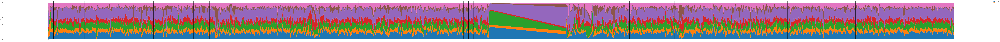

In [38]:
#location_score_dict = {}
ldatas = []
#genomic_locations = []
for location, dists in locations.items():
    total = np.zeros(num_topics)
    for dist in dists:
        for topic, prob in dist:
            total[topic] += prob
    avg = total / sum(total)
    #location_score_dict[location] = total
    ldatas.append((location, avg))
    '''
    all_dists = locations[location]
    print(locations[location])
    avg_dist = np.sum(all_dists)/len(all_dists)
    '''
ldatas.sort()
x = [d[0] for d in ldatas]
y = np.stack([d[1] for d in ldatas]).T
print(y)
plt.figure(figsize=(250,10))
plt.xlabel('location')
plt.ylabel('topic distribution')
label_array = ["cluster " + str(i) for i in range(num_topics)]

for xc in enhancers:
    plt.axvline(x=xc, color='black')

plt.stackplot(x, y, labels=label_array)
plt.legend()
plt.show()

In [ ]:
dist

In [36]:
enhancers = []
with open('../../data/enhancers.tsv', 'r') as f:
    skip = True
    for line in f:
        if skip:
            skip = False
            continue
        tokens = line.split()
        start = tokens[2]
        end = tokens[3]
        binn = tokens[0]
        if int(binn) <8:
            continue
        
        if 'enh' in tokens[4].lower():
            enhancers.append(int(start)//100000)
            
enhancers = sorted(enhancers)
        
        

In [37]:
import matplotlib.pyplot as plt
import numpy as np

start = 0
ncorpus = len(corpus)
dists = np.zeros((num_topics, ncorpus))

for i, document in enumerate(corpus[start : start + ncorpus]):
    dist = lda[document]
    for topic, percentage in dist:
        dists[topic, i] = percentage


plt.figure(figsize=(450,20))
plt.xlabel('location')
plt.ylabel('topic distribution')
label_array = ["cluster " + str(i) for i in range(num_topics)]
for xc in enhancers:
    plt.axvline(x=xc, color='black')

plt.stackplot(genomic_locations, dists, labels=label_array)
plt.legend()
plt.show()

KeyboardInterrupt: 

In [74]:
import operator
diseases = [{} for i in range(num_topics)]
tfs = [{} for i in range(num_topics)]

for idx in range(num_topics):
    topic = lda.show_topic(idx, 2000)
    topic
    for value, prob in topic:
        disease, tf = eval(value)
        if disease not in diseases[idx]:
            diseases[idx][disease] = 0
        if tf not in tfs[idx]:
            tfs[idx][tf] = 0
        diseases[idx][disease] += prob
        tfs[idx][tf] += prob

top_diseases = [sorted(x.items(), key=operator.itemgetter(1), reverse=True) for x in diseases]
top_tfs = [sorted(x.items(), key=operator.itemgetter(1), reverse=True) for x in tfs]

for idx in range(num_topics):
    print('Topic %d' % idx)
    print(top_diseases[idx][0:5])
    print(top_tfs[idx][:5])

Topic 0
[('Basal metabolic rate', 0.024082710788206896), (' Weight', 0.019125806567899417), (' Platelet count', 0.016985449561616406), ('Body mass index (BMI)', 0.01602671003274736), ('Body fat percentage', 0.010824543893249938)]
[('D00353.005_SELEX_EGR2', 0.001464210799895227), ('D00520.002_SELEX_MLX', 0.0009300275305577088), ('D00557.002_SELEX_NR3C2', 0.0007352732645813376), ('D00693.002_SELEX_THRB', 0.0006879346583446022), ('D00324.003_SELEX_CREB3L1', 0.0006437166084651835)]
Topic 1
[('Basal metabolic rate', 0.02406146968496614), (' Weight', 0.01848982616138528), (' Platelet count', 0.016724607681680936), ('Body mass index (BMI)', 0.015694926161813783), ('Body fat percentage', 0.010734476469224319)]
[('D00353.005_SELEX_EGR2', 0.0012328474113019183), ('D00520.002_SELEX_MLX', 0.0009191324606945273), ('D00631.002_SELEX_SCRT2', 0.0006779069772164803), ('D00537.001_SELEX_NFIB', 0.000675615381624084), ('D00388.003_SELEX_FIGLA', 0.000669259468850214)]
Topic 2
[('Basal metabolic rate', 0.02

10